# UNCOVER RGB mosaics

Creating RGB images for the UNCOVER NIRCam primary and NIRISS parallel mosaics

In [1]:
# Load scripts
import numpy as np
import scripts_UNCOVER_mosaics

In [2]:
# Load matplotlib for the jupyter NB
import matplotlib as mpl

--------------
## NIRCam primary mosaic

In [3]:
filters_all_NIRCAM = ['F115W', 'F150W', 'F200W', 'F277W', 'F356W', 'F410M', 'F444W']

# Non-PSF-matched images:
path_images = '/Users/sedona/Dropbox/UNCOVER/imaging/UNCOVER/'

filenames_NIRCAM = [path_images+'abell2744clu-grizli-v5.4-f115w-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f150w-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f200w-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f277w-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f356w-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f410m-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f444w-clear_drc_sci.fits.gz']


upsample=False 

data_all_NIRCAM = {}

for filt, fname in zip(filters_all_NIRCAM, filenames_NIRCAM):
    dattmp = scripts_UNCOVER_mosaics.load_data(fname, filt=filt, upsample=upsample)
    data_all_NIRCAM[filt] = dattmp

In [4]:
# Combine filters for the B, G, R images (sum of individual filters)

filters_RGBsum_NIRCAM=['F115W+F150W', 'F200W+F277W', 'F356W+F410M+F444W']
dataRGBsum_NIRCAM = scripts_UNCOVER_mosaics.make_dataRGB(data_all=data_all_NIRCAM, 
                                                         filters=filters_RGBsum_NIRCAM)

In [5]:
# Free up memory of unnecessary copies of images:
data_all_NIRCAM = None

In [6]:
# Calculate scaling factors: 

cols = ['r', 'g', 'b'] 

pctl_u = 99.996 

scale_min_NIRCAM = []
scale_max_NIRCAM = []

min_val = 0.

for col in cols:
    pctl = np.percentile(dataRGBsum_NIRCAM['{}IMG'.format(col)], pctl_u)
    scale_min_NIRCAM.append(min_val)
    scale_max_NIRCAM.append(pctl)
    
print("scale_min_NIRCAM={}".format(scale_min_NIRCAM))
print("scale_max_NIRCAM={}".format(scale_max_NIRCAM))

scale_min_NIRCAM=[0.0, 0.0, 0.0]
scale_max_NIRCAM=[591.6161676569527, 752.6162721178753, 730.8826354576013]


Below is an example of plotting the NIRCam RGB mosaic, with insets 
zooming in on the 3 cluster cores

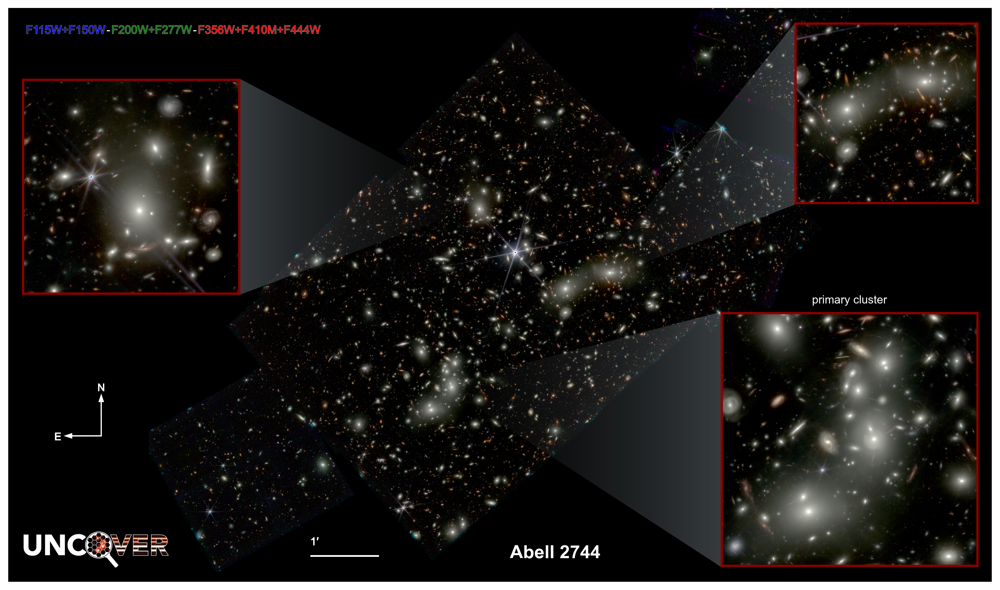

In [7]:
# Plot mosaics: with insets

# Some settings for use with the JupyterNB
%matplotlib inline
dpi = 300
mpl.rcParams['figure.dpi']= dpi


dpi = 100

# Note: the NIRCAM mosaic with insets is so large that 
#  Matplotlib cannot save the image with 3600 dpi.

# Get the settings for this mosaic:
dict_fieldopts = scripts_UNCOVER_mosaics._get_dict_NIRCAM_primary(dataRGBsum_NIRCAM['rIMG'].shape,
                                                                noinsets=False)

# Get the appropriate size of the moscaic "scaling", 
# ensuring similar appearance for different DPI images
plot_scale_inches= dict_fieldopts['rgb_big_shape'][0]/float(1800)

fout = None

scripts_UNCOVER_mosaics.plot_full_mosaic_RGB(fileout=fout, data=dataRGBsum_NIRCAM, 
                       plot_scale_inches=plot_scale_inches, dpi=dpi, 
                       minimum=scale_min_NIRCAM, maximum=scale_max_NIRCAM, 
                       scalea=1500, imscale_type='log',
                       dict_fieldopts=dict_fieldopts)

Alternatively, different RGB mosaic options can be passed to show, eg, no insets

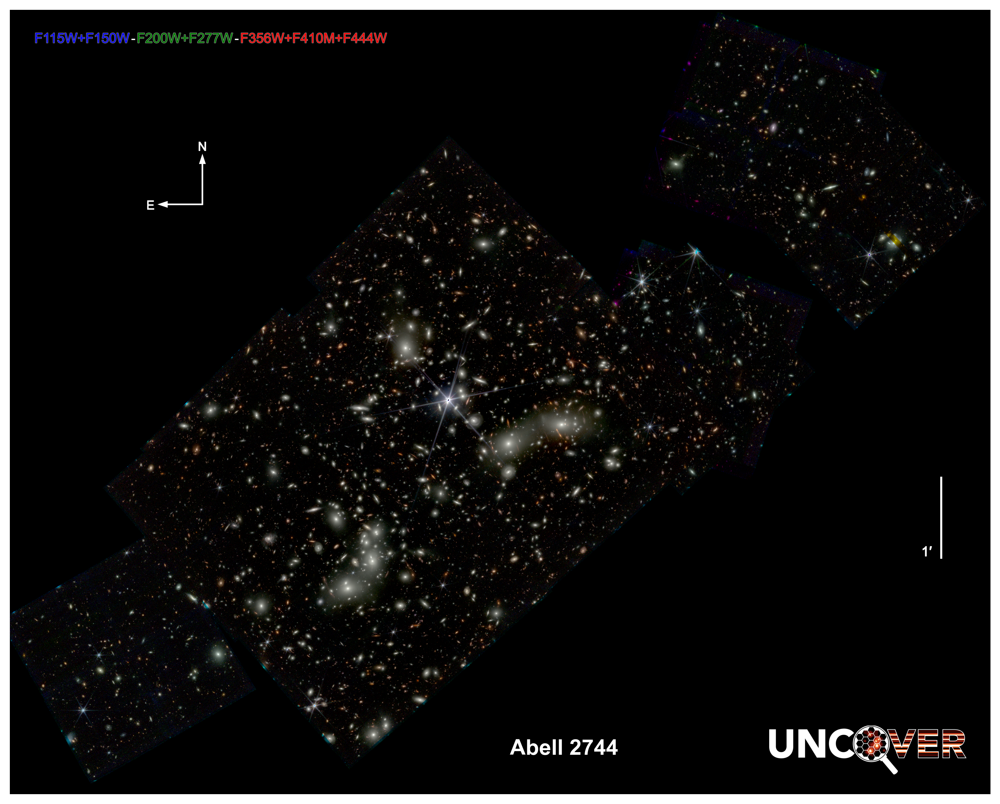

In [8]:
# Plot mosaics: without insets

# Some settings for use with the JupyterNB
%matplotlib inline
dpi = 300
mpl.rcParams['figure.dpi']= dpi


dpi = 100

# Get the settings for this mosaic:
dict_fieldopts = scripts_UNCOVER_mosaics._get_dict_NIRCAM_primary(dataRGBsum_NIRCAM['rIMG'].shape,
                                                                noinsets=True)


# Get the appropriate size of the moscaic "scaling", 
# ensuring similar appearance for different DPI images
plot_scale_inches= dict_fieldopts['rgb_big_shape'][0]/float(1800)

fout = None

scripts_UNCOVER_mosaics.plot_full_mosaic_RGB(fileout=fout, data=dataRGBsum_NIRCAM, 
                       plot_scale_inches=plot_scale_inches, dpi=dpi, 
                       minimum=scale_min_NIRCAM, maximum=scale_max_NIRCAM, 
                       scalea=1500, imscale_type='log',
                       dict_fieldopts=dict_fieldopts)

The following commented-out code are examples of saving the RGB mosaics to file. 

For high resolutions (eg, 3000+ dpi), it is better to upsample the LW to 
allow for the full SW resolution to be used. 

In [9]:
# # Plot mosaics: with insets

# dpis = [1800, 900, 600, 300]

# # Note: the NIRCAM mosaic with insets is so large that 
# #  Matplotlib cannot save the image with 3600 dpi.

# # Get the settings for this mosaic:
# dict_fieldopts = scripts_UNCOVER_mosaics._get_dict_NIRCAM_primary(dataRGBsum_NIRCAM['rIMG'].shape,
#                                                                 noinsets=False)

# # Get the appropriate size of the moscaic "scaling", 
# # ensuring similar appearance for different DPI images
# plot_scale_inches= dict_fieldopts['rgb_big_shape'][0]/float(1800)


# output_path = '/Users/sedona/Dropbox/UNCOVER/mosaic_plots_survey_paper/'
    
# for dpi in dpis:
#     fout = output_path+'UNCOVER_nircam_mosaic_dpi{}_insets.png'.format(dpi)

#     scripts_UNCOVER_mosaics.plot_full_mosaic_RGB(fileout=fout, data=dataRGBsum_NIRCAM, 
#                            plot_scale_inches=plot_scale_inches, dpi=dpi, 
#                            minimum=scale_min_NIRCAM, maximum=scale_max_NIRCAM, 
#                            scalea=1500, imscale_type='log',
#                            dict_fieldopts=dict_fieldopts)

In [10]:
# # Plot mosaics: no insets

# dpis = [3600, 1800, 900, 600, 300]


# # Get the settings for this mosaic:
# dict_fieldopts = scripts_UNCOVER_mosaics._get_dict_NIRCAM_primary(dataRGBsum_NIRCAM['rIMG'].shape,
#                                                                 noinsets=True)

# # Get the appropriate size of the moscaic "scaling", 
# # ensuring similar appearance for different DPI images
# plot_scale_inches= dict_fieldopts['rgb_big_shape'][0]/float(1800)


# output_path = '/Users/sedona/Dropbox/UNCOVER/mosaic_plots_survey_paper/'
    
# for dpi in dpis:
#     fout = output_path+'UNCOVER_nircam_mosaic_dpi{}.png'.format(dpi)

#     scripts_UNCOVER_mosaics.plot_full_mosaic_RGB(fileout=fout, data=dataRGBsum_NIRCAM, 
#                            plot_scale_inches=plot_scale_inches, dpi=dpi, 
#                            minimum=scale_min_NIRCAM, maximum=scale_max_NIRCAM, 
#                            scalea=1500, imscale_type='log',
#                            dict_fieldopts=dict_fieldopts)

--------------
## NIRISS parallel mosaic

In [11]:
filters_all_NIRISS = ['F115W', 'F150W', 'F200W', 'F356W', 'F444W']

# Non-PSF-matched images:
path_images = '/Users/sedona/Dropbox/UNCOVER/imaging/UNCOVER/'

filenames_NIRISS = [path_images+'abell2744clu-grizli-v5.4-f115wn-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f150wn-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-f200wn-clear_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-clearp-f356w_drc_sci.fits.gz',
                    path_images+'abell2744clu-grizli-v5.4-clearp-f444w_drc_sci.fits.gz']


upsample=False

data_all_NIRISS = {}

for filt, fname in zip(filters_all_NIRISS, filenames_NIRISS):
    dattmp = scripts_UNCOVER_mosaics.load_data(fname, filt=filt, upsample=upsample)
    data_all_NIRISS[filt] = dattmp

In [12]:
# Combine filters for the B, G, R images (sum of individual filters)

filters_RGBsum_NIRISS=['F115W+F150W', 'F200W', 'F356W+F444W']
dataRGBsum_NIRISS = scripts_UNCOVER_mosaics.make_dataRGB(data_all=data_all_NIRISS, 
                                                         filters=filters_RGBsum_NIRISS)

In [13]:
# Free up memory of unnecessary copies of images:
data_all_NIRISS = None

In [14]:
# Calculate scaling factors: 

cols = ['r', 'g', 'b'] 

pctl_u = 99.996 

scale_min_NIRISS = []
scale_max_NIRISS = []

min_val = 0.

#-----------------------
## NIRISS: CROP TO AVOID TOO MANY EMPTY PIXELS)
rgb_shape = dataRGBsum_NIRISS['rIMG'].shape
crop_y_fac = [0.175, 0.875]

crop_y_pix = [int(crop_y_fac[0]*rgb_shape[0]),
              int(crop_y_fac[1]*rgb_shape[0])]

crop_x_fac = [0.585, 1.]

crop_x_pix = [int(crop_x_fac[0]*rgb_shape[1]),
              int(crop_x_fac[1]*rgb_shape[1])]
#-----------------------

for col in cols:
    imgcrop = dataRGBsum_NIRISS['{}IMG'.format(col)][crop_y_pix[0]:crop_y_pix[1], 
                                                     crop_x_pix[0]:crop_x_pix[1]]
    pctl = np.percentile(imgcrop, pctl_u)
    scale_min_NIRISS.append(min_val)
    scale_max_NIRISS.append(pctl)
    
print("scale_min_NIRISS={}".format(scale_min_NIRISS))
print("scale_max_NIRISS={}".format(scale_max_NIRISS))

scale_min_NIRISS=[0.0, 0.0, 0.0]
scale_max_NIRISS=[368.2296543005391, 202.86254410888705, 281.15480353759904]


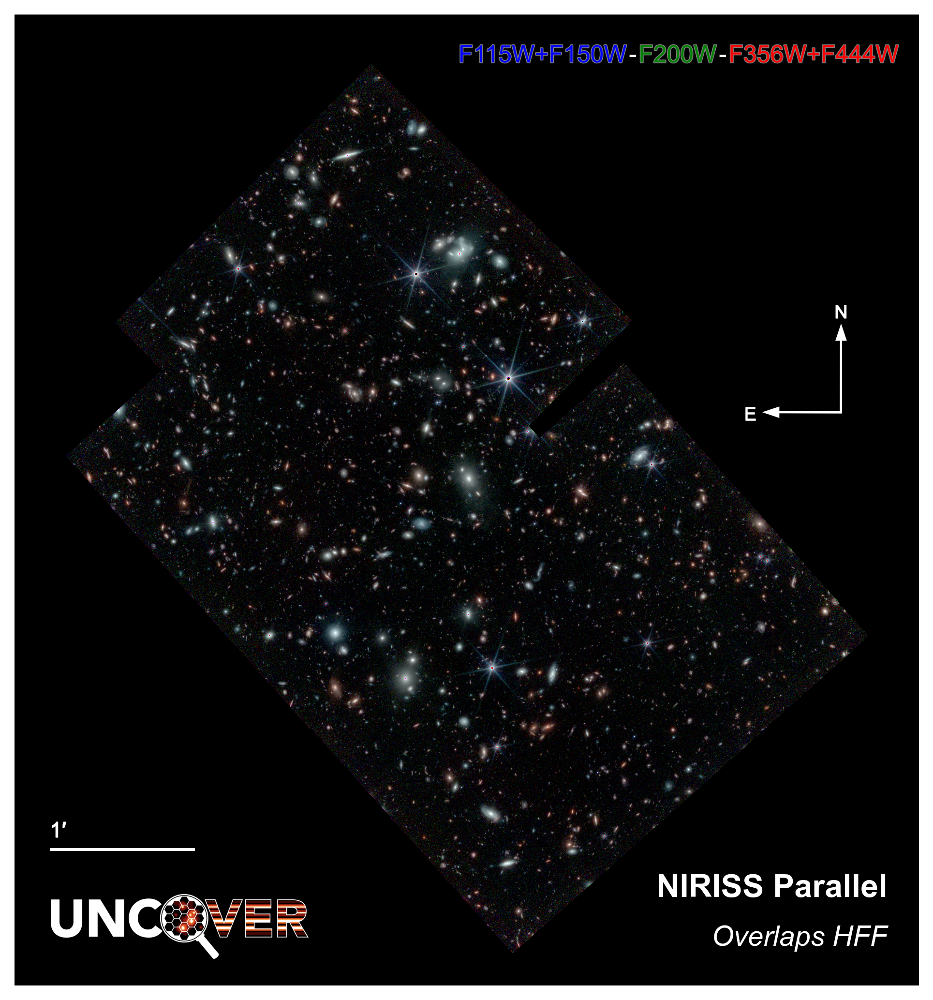

In [15]:
# Plot mosaics

# Some settings for use with the JupyterNB
%matplotlib inline
dpi = 300
mpl.rcParams['figure.dpi']= dpi


dpi = 100

dict_fieldopts=scripts_UNCOVER_mosaics._get_dict_NIRISS_parallel(dataRGBsum_NIRISS['rIMG'].shape)

# Get the appropriate size of the moscaic "scaling", 
# ensuring similar appearance for different DPI images
plot_scale_inches= dict_fieldopts['rgb_big_shape'][0]/float(1500)

fout = None

scripts_UNCOVER_mosaics.plot_full_mosaic_RGB(fileout=fout, data=dataRGBsum_NIRISS, 
                       plot_scale_inches=plot_scale_inches, dpi=dpi, 
                       minimum=scale_min_NIRISS, maximum=scale_max_NIRISS, 
                       scalea=1500, imscale_type='log',
                       dict_fieldopts=dict_fieldopts)

The following commented-out code is an example of saving the RGB mosaics to file. 

In [16]:
# # Plot mosaics

# dpis = [1500, 900, 600, 300]

# dict_fieldopts=scripts_UNCOVER_mosaics._get_dict_NIRISS_parallel(dataRGBsum_NIRISS['rIMG'].shape)

# # Get the appropriate size of the moscaic "scaling", 
# # ensuring similar appearance for different DPI images
# plot_scale_inches= dict_fieldopts['rgb_big_shape'][0]/float(1500)

# output_path = '/Users/sedona/Dropbox/UNCOVER/mosaic_plots_survey_paper/'
    
# for dpi in dpis:
#     fout = output_path+'UNCOVER_niriss_parallel_mosaic_dpi{}.png'.format(dpi)

#     scripts_UNCOVER_mosaics.plot_full_mosaic_RGB(fileout=fout, data=dataRGBsum_NIRISS, 
#                            plot_scale_inches=plot_scale_inches, dpi=dpi, 
#                            minimum=scale_min_NIRISS, maximum=scale_max_NIRISS, 
#                            scalea=1500, imscale_type='log',
#                            dict_fieldopts=dict_fieldopts)

---------